<a href="https://colab.research.google.com/github/vgaurav3011/100-Days-of-ML/blob/master/Music_Generator.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

     |████████████████████████████████| 2.1MB 4.7MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114586 sha256=a35f24fcc9cc072bfa0e520465a5446d7c6a19f596ff38eef9ac94515b6c7a5e
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning


In [2]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [3]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

In [0]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


In [0]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d", 
#   we can evaluate `char2idx["d"]`.  
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

In [0]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [0]:
### Vectorize the songs string ###

'''TODO: Write a function to convert the all songs string to a vectorized
    (i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.

  NOTE: the output of the `vectorize_string` function 
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''


def vectorize_string(string):
  l1=[]
  d=len(string)
  for i in range(d):
    l1.append(char2idx[string[i]])
  return(np.array(l1))
vectorized_songs = vectorize_string(songs_joined)

In [0]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:2\nT:An B' ---- characters mapped to int ----> [49 22 14  0 45 22 26 69  1 27]


In [0]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  '''TODO: construct a list of input sequences for the training batch'''
  input_batch = [vectorized_songs[idx[i]:idx[i]+seq_length] for i in range(batch_size)]
  output_batch = [vectorized_songs[idx[i]+1:idx[i]+seq_length+1] for i in range(batch_size)]


  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  print(x_batch)
  return x_batch, y_batch


# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[[27 58  1 59 15 82 53  2  0 36]
 [58  9 73 60 60 67  9 14 19 18]]
[PASS] test_batch_func_types
[[75 63 60  1 42 76 56 66 60 73]
 [30 82 29 14 31 26  1 59 15 27]]
[PASS] test_batch_func_shapes
[[ 1 56 61 59 82 58 26 26  1 30]
 [66 56  9 15 13  0 38 22 14 11]]
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [0]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

[[26  8  1 27  8]]
Step   0
  input: 26 ('A')
  expected output: 8 (',')
Step   1
  input: 8 (',')
  expected output: 1 (' ')
Step   2
  input: 1 (' ')
  expected output: 27 ('B')
Step   3
  input: 27 ('B')
  expected output: 8 (',')
Step   4
  input: 8 (',')
  expected output: 32 ('G')


In [0]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [0]:
### Defining the RNN Model ###

'''TODO: Add LSTM and Dense layers to define the RNN model using the Sequential API.'''
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors 
    #   of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units. 
    # TODO: Call the LSTM function defined above to add this layer.
    LSTM(rnn_units),
 
    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size. 
    # TODO: Add the Dense layer.
    tf.keras.layers.Dense(vocab_size,activation='softmax')
  ])

  return model

# Build a simple model with default hyperparameters. You will get the 
#   chance to change these later.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [0]:
model.summary()

Model: "sequential_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_40 (Embedding)     (32, None, 256)           21248     
_________________________________________________________________
lstm_40 (LSTM)               (32, None, 1024)          5246976   
_________________________________________________________________
dense_40 (Dense)             (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [0]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

[[67 67 64 ... 27 26  1]
 [32 30 82 ... 32 32  1]
 [ 0 61 14 ... 32  1 38]
 ...
 [ 0 56 62 ... 29  1 38]
 [58 58 14 ... 56 61 60]
 [60 62  1 ... 49 22 15]]
Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


In [0]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([45,  3,  6, 21, 66, 74, 73, 52, 41, 72, 51,  3, 30, 73, 40, 10, 82,
       13, 15, 60,  3, 36, 30, 55, 50, 54,  2, 15, 29, 48, 32,  8, 30, 33,
       18, 16, 45, 73, 49, 28, 13, 13, 12, 74,  7, 47, 34,  8, 52,  7,  0,
       79, 80, 31, 78, 70, 36, 59,  9, 15, 50, 79, 65, 20, 43, 71, 12, 58,
       39, 17, 52, 72, 39, 77,  8, 59, 51, 13, 15, 16, 12, 10, 17,  7, 21,
       75, 44, 21, 30, 66, 36, 28, 15, 20,  3, 61, 37, 30, 45, 51])

In [0]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 "llivan's\nZ: id:dc-polka-5\nM:2/4\nL:1/8\nK:A Major\na2 a>f|ec a>f|ec a>f|ec BA|!\na2 a>f|ec a2|ce B>c|BA "

Next Char Predictions: 
 'L=rvmwKlY_J JyRdaTPv9\nIETvO,1uK3aK7|z48cA^By9uXYPk>MFe=F0aV\nEk7hQbWq]sW)3B^jpbuLpqZ7/pf3Iy4dHeHh[_TT'


In [0]:
### Defining the loss function ###

'''TODO: define the loss function to compute and return the loss between
    the true labels and predictions (logits). Set the argument from_logits=True.'''
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True) # TODO
  return loss

'''TODO: compute the loss using the true next characters from the example batch 
    and the predictions from the untrained model several cells above'''
example_batch_loss = compute_loss(x, pred) 

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4180694


In [0]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 3000  # Increase this to train longer
batch_size = 64  # Experiment between 1 and 64
seq_length = 250  # Experiment between 50 and 500
learning_rate = 1e-2  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 128  # Experiment between 1 and 2048

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

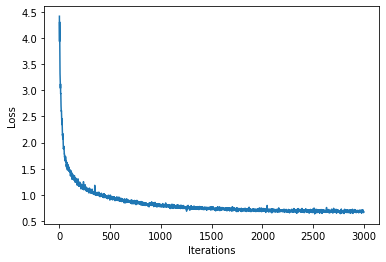

100%|██████████| 3000/3000 [01:15<00:00, 39.90it/s]


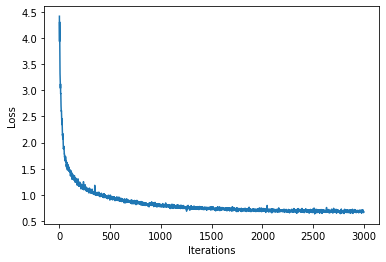

In [0]:
### Define optimizer and training operation ###
from keras import optimizers
import numpy
'''TODO: instantiate a new model for training using the `build_model`
  function and the hyperparameters created above.'''
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

'''TODO: instantiate an optimizer with its learning rate.
  Checkout the tensorflow website for a list of supported optimizers.
  https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/
  Try using the Adam optimizer to start.'''
optimizer = tf.keras.optimizers.RMSprop(
    learning_rate, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False,
    name='RMSprop'
)
@tf.function
def train_step(x, y): 
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
    
    '''TODO: feed the current input into the model and generate predictions'''
    y_hat = model(x)
    
    '''TODO: compute the loss!'''
    loss = compute_loss(y, y_hat)
    
  # Now, compute the gradients 
  '''TODO: complete the function call for gradient computation. 
      Remember that we want the gradient of the loss with respect all 
      of the model parameters. 
      HINT: use `model.trainable_variables` to get a list of all model
      parameters.'''
   
  grads = tape.gradient(loss, model.variables)
  
  # Apply the gradients to the optimizer so iprint(model.trainable_variables)t can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)


In [0]:
'''TODO: Rebuild the model using a batch_size=1'''
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_45"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_46 (Embedding)     (1, None, 256)            21248     
_________________________________________________________________
lstm_46 (LSTM)               (1, None, 128)            197120    
_________________________________________________________________
dense_46 (Dense)             (1, None, 83)             10707     
Total params: 229,075
Trainable params: 229,075
Non-trainable params: 0
_________________________________________________________________


In [0]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length):
  # Evaluation step (generating ABC text using the learned RNN model)

  '''TODO: convert the start string to numbers (vectorize)'''
  input_eval = [ vectorize_string(start_string)]
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''TODO: evaluate the inputs and generate the next character predictions'''
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
     
      '''TODO: use a multinomial distribution to sample'''
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
     
      '''TODO: add the predicted character to the generated text!'''
      # Hint: consider what format the prediction is in vs. the output
      text_generated.append((idx2char[predicted_id]))
    
  return (start_string + ''.join(text_generated))

In [0]:
'''TODO: Use the model and the function defined above to generate ABC format text of length 1000!
    As you may notice, ABC files start with "X" - this may be a good start string.'''
generated_text = generate_text(model, start_string="X", generation_length=2000) # TODO
# generated_text = generate_text('''TODO''', start_string="X", generation_length=1000)

100%|██████████| 10000/10000 [00:43<00:00, 229.64it/s]


In [0]:
print(generated_text)

A|Bdc d2:|!
K:A Mixolydian
dcAG FADA|DGGF GABc|defg afde|fga^g afdf|!
agfa b2af|e2cf ecBA|F2AF DFAd|BgdB BA:|!
K:G Major
BA|GBB2 A2GB|c2AB c2B2|ABAG EGG2|ceA2 cAG|]!

X:211
T:Masut of the Roagh
Z: id:dc-jig-77
M:6/8
L:1/8
K:D Major
E|DFAF BFEF|DFAF ABAF|DFAF E2eg|f2fe dBAF|!
E2eB GEEB,|AGEd BdBG|A2BG E2DF|!
E2BE ABdB|ADFD E3F|EDB,D G3A|BABc d3|]!
ABc|d2fd adfd|Bdef gfed|Bdef g2AB|deed Bcde|f2f2 agfe|dBBA B2ef|!
efge fgaf|ecdB AGE2|defg a2fg|a2ba !
fdf2 dfeg|fedf eBB2|f2fe dcBA|!
f2fe dcdf|eAce fgaf|ecBc EcED|!
A,DDE FEDF|[1 f3f edBA|Bdef gfef|g2bg edBd|AGFE DEFD|!
a2a2b age|dBB B2e|dBB G3|!
[1 efg dBA|GBd ege|dBA G2A|B2G G2 G2|]!

X:37
T:Kerry Hif the Bush
Z: id:dc-reel-117
M:C
L:1/8
K:D Major
d|cAAB cAFG|AcG2 cEE2|d2A2 ABcA|d3c d2:|!
cd|eAA2 efec|BABc AGED|GABG AGEG|A3B cAGE|!
DDEG AGAc|BdBG GBAG|EAAG FDD2|G2BG G2GB|!
cABG A2FA|d2de dBB2|dBeB dBAF|GBEF GABG|BAGB A2GB|!
eBB2 eBdef|gfed cdeA|dBAG FDD|]!
A,DDE FAA|def fef|afg faf|e2e efg|!
fBB fBB|fBB B2g|f2d d2B|AFE EFE|!
D2F AFE|DFAB d

In [0]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)
for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 

  print("Generated song", i)
  ipythondisplay.display(waveform)

Found 35 songs in text
ERROR! Session/line number was not unique in database. History logging moved to new session 68
Generated song 0
